In [1]:
!nvidia-smi

Sun Feb 18 12:57:45 2018       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 384.111                Driver Version: 384.111                   |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX 108...  Off  | 00000000:01:00.0  On |                  N/A |
| 23%   36C    P0    79W / 250W |    387MiB / 11171MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  GeForce GTX TIT...  Off  | 00000000:02:00.0 Off |                  N/A |
| 26%   32C    P8    13W / 250W |      2MiB /  6082MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
        

In [2]:
!conda install pytorch torchvision -c pytorch -y

Fetching package metadata .............
Solving package specifications: .

# All requested packages already installed.
# packages in environment at /home/yvan/anaconda3/envs/data_sci_bowl_2018:
#
pytorch                   0.3.1           py36_cuda8.0.61_cudnn7.0.5_2    pytorch
torchvision               0.2.0            py36h17b6947_1    pytorch


In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils import data
from torch.nn.modules.loss import _Loss
from torch.autograd import Variable, Function

from torchvision.datasets import ImageFolder
from torchvision import transforms, datasets

# Constants

In [4]:
BATCH_SIZE = 64
IMG_PATH = '/home/yvan/projects/data_sci_bowl_2018/data'
N_EPOCHS = 10
FILTER_DEPTH = 3
LR = 0.0001

# Data Processing

In [5]:
# data process
img_transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.ToTensor()
])

img_dataset = ImageFolder(os.path.join(IMG_PATH, 'train_img'), img_transform)
img_loader = data.DataLoader(dataset=img_dataset,
                             batch_size=BATCH_SIZE,
                             shuffle=False,
                             num_workers=1)

In [6]:
# mask process
mask_transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.ToTensor()
])

mask_dataset = ImageFolder(os.path.join(IMG_PATH,'train_mask'),mask_transform)
mask_loader = data.DataLoader(dataset=mask_dataset,
                              batch_size=BATCH_SIZE,
                              shuffle=False,
                              num_workers=1)

In [7]:
for x in zip(img_loader, mask_loader):
    a,b = x[0][0], x[1][0]
    print(a.size(), b.size())
    break

torch.Size([64, 3, 128, 128]) torch.Size([64, 3, 128, 128])


In [8]:
from PIL import Image
import matplotlib.pyplot as plt

test_img = transforms.ToPILImage()(a[0])
test_mask = transforms.ToPILImage()(b[0])

In [9]:
torch.max(a[0]), torch.min(a[0]), torch.max(b[0]), torch.min(b[0])

(0.40392157435417175, 0.003921568859368563, 1.0, 0.0)

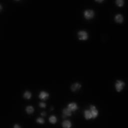

In [10]:
test_img

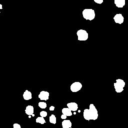

In [11]:
test_mask

Ok so we can convert our stuff into tensors and convert them back into images.

# Unet model

referenced: https://github.com/milesial/Pytorch-UNet/blob/master/unet/unet_parts.py

In [12]:
def check_param_sum(model):
    return sum([torch.sum(param).data[0] for param in model.parameters()])

def to_variable(x):
    if torch.cuda.is_available():
        x = x.cuda()
    return Variable(x)

class DiceCoeff(Function):
    def forward(self, input, target):
        self.save_for_backward(input, target)
        self.inter = torch.dot(input, target) + 0.0001
        self.union = torch.sum(input) + torch.sum(target) +0.0001
        
        t = 2*self.inter.float()/self.union.float()
        return t
    
    def backward(self, grad_output):
        input,target = self.saved_variables
        grad_input = grad_target = None
        if self.needs_input_grad[0]:
            grad_input = grad_output *2* (target * self.union + self.inter) / self.union*self.union
            
        if self.needs_input_grad[1]:
            grad_target = None
        return grad_input, grad_target
    
def dice_coeff(input, target):
    if input.is_cuda:
        s = Variable(torch.FloatTensor(1).cuda().zero_())
    else:
        s = Variable(torch.FloatTensor(1).zero_())
        
    for i,c in enumerate(zip(input, target)):
        s = s + DiceCoeff().forward(c[0], c[1])
        
    return s / (i+1)

class DiceLoss(_Loss):
    def forward(self, input, target):
        return 1 - dice_coeff(F.sigmoid(input), target)
    
### conv building block ###

class conv_block(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(conv_block, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_chan, out_chan, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(out_chan, out_chan, 3, padding=1),
            nn.ReLU()
        )
        
    def forward(self, x):
        x = self.conv(x)
        return x

### inputs and outputs ###

class in_conv(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(in_conv, self).__init__()
        self.conv = conv_block(in_chan, out_chan)
        
    def forward(self, x):
        x = self.conv(x)
        return x
        
class out_conv(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(out_conv, self).__init__()
        self.conv = nn.Conv2d(in_chan, out_chan, 1)
        self.activation = nn.Sigmoid()
        
    def forward(self, x):
        x = self.conv(x)
        x = self.activation(x)
        return x
    
### actual con blocks ###

class conv_down(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(conv_down, self).__init__()
        self.pool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            conv_block(in_chan, out_chan)
        )
        
    def forward(self, x):
        x = self.pool_conv(x)
        return x

class conv_up(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(conv_up, self).__init__()
        self.conv_up = nn.ConvTranspose2d(in_chan, out_chan, 2, stride=2)
        self.conv = conv_block(in_chan+out_chan, out_chan)
    
    def forward(self, x1, x2):
        x1 = self.conv_up(x1)
        x = torch.cat([x2,x1],dim=1)
        x = self.conv(x)
        return x

class unet1(nn.Module):
    def __init__(self, in_chan, out_chan):
        super(unet1, self).__init__()
        self.inc = in_conv(in_chan, 64)
        self.down1 = conv_down(64, 128)
        self.down2 = conv_down(128, 256)
        self.down3 = conv_down(256, 512)
        self.down4 = conv_down(512, 512)
        self.up1 = conv_up(512, 256)
        self.up2 = conv_up(256, 128)
        self.up3 = conv_up(128, 64)
        self.up4 = conv_up(64, 32)
        self.out = out_conv(32, out_chan)
        
    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.out(x)
        return x

In [13]:
# create a unet
unet = unet1(FILTER_DEPTH, FILTER_DEPTH)
opti = optim.Adam(unet.parameters(), lr=LR, betas=(0.5,0.99))
loss = DiceLoss()

nparams = sum([param.nelement() for param in unet.parameters()])
psum = check_param_sum(unet)
print(f'creating model with {nparams} params and intial param sum {psum}')

if torch.cuda.is_available():
    unet.cuda()
    loss.cuda()

losses = []

for epoch in range(N_EPOCHS*5):
    epoch_loss = []
    print(f'training epoch {epoch}')
    for batch, mask_batch in zip(img_loader, mask_loader):
        image_batch = to_variable(batch[0])
        labels = to_variable(mask_batch[0])
        # in 64, 3, 128, 128
        batch_size = image_batch.size(0)
        # out 64, 3, 64, 64
        x = unet(image_batch)
        l = loss(x, labels)
        epoch_loss.append(l.data[0])
        l.backward()
        opti.step()
        unet.zero_grad()
    losses.append(np.mean(epoch_loss))
    epoch_loss = []
    
print(losses)

creating model with 13236291 params and intial param sum 53.821313332766294
training epoch 0
training epoch 1
training epoch 2
training epoch 3
training epoch 4
training epoch 5
training epoch 6
training epoch 7
training epoch 8
training epoch 9
training epoch 10
training epoch 11
training epoch 12
training epoch 13
training epoch 14
training epoch 15
training epoch 16
training epoch 17
training epoch 18
training epoch 19
training epoch 20
training epoch 21
training epoch 22
training epoch 23
training epoch 24
training epoch 25
training epoch 26
training epoch 27
training epoch 28
training epoch 29
training epoch 30
training epoch 31
training epoch 32
training epoch 33
training epoch 34
training epoch 35
training epoch 36
training epoch 37
training epoch 38
training epoch 39
training epoch 40
training epoch 41
training epoch 42
training epoch 43
training epoch 44
training epoch 45
training epoch 46
training epoch 47
training epoch 48
training epoch 49
[0.793183299628171, 0.792823536829

Woooooo we've got a decreasing loss function. Let's print the predictions before doing anything else.

In [15]:
def rescale(X,xmin,xmax):
    _std = (X - X.min()) / (X.max() - X.min())
    return _std * (xmax - xmin) + xmin

def show_one(file):
    image = Image.open(file, 'r')
    plt.imshow(np.asarray(image))
    plt.axis('off')
    
def show_n(img_files, n=6):
    _, ax = plt.subplots(1, n, sharex='col', sharey='row', figsize=(24,6))
    
    for i, img_file in enumerate(img_files):
        ax[i].imshow(img_file)
        ax[i].axis('off')

def chunker(seq, size):
    return (seq[pos:pos + size] for pos in range(0, len(seq), size))

predicted_masks = []
actual_masks = []
for batch, mask_batch in zip(img_loader, mask_loader):
    image_batch = to_variable(batch[0])
    labels = to_variable(mask_batch[0])
    x = unet(image_batch)
    for i, l in zip(x.data, labels.data):
        scaled = rescale(i,0,1)
        predicted_masks.append(transforms.ToPILImage()(scaled.cpu()))
        scaled = rescale(l,0,1)
        actual_masks.append(transforms.ToPILImage()(scaled.cpu()))

In [16]:
assert len(predicted_masks) == len(actual_masks)

/home/yvan/anaconda3/envs/data_sci_bowl_2018/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


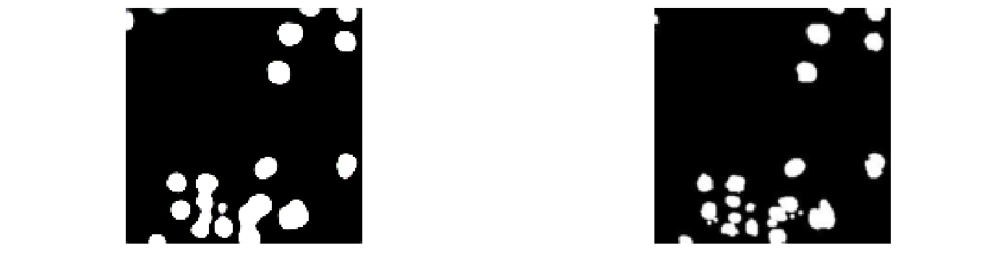

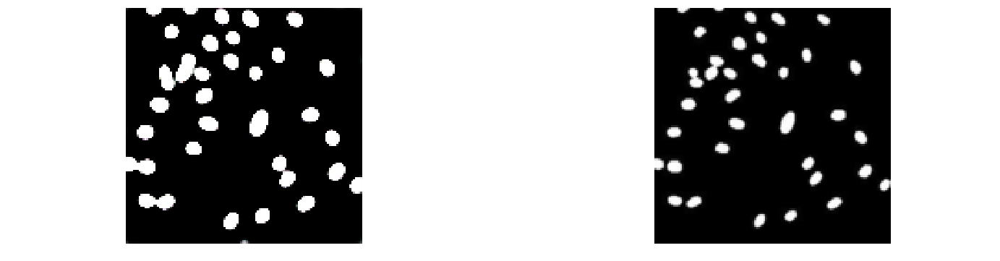

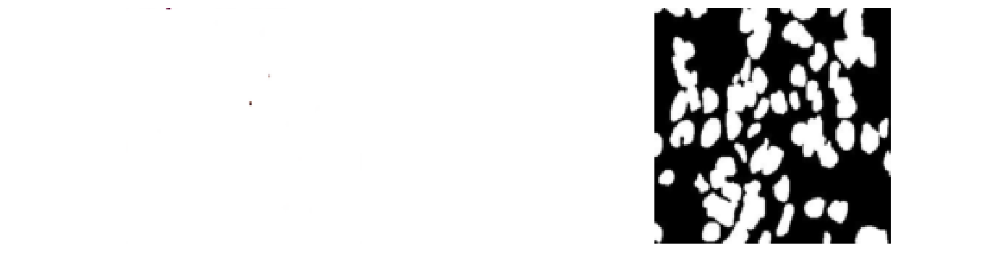

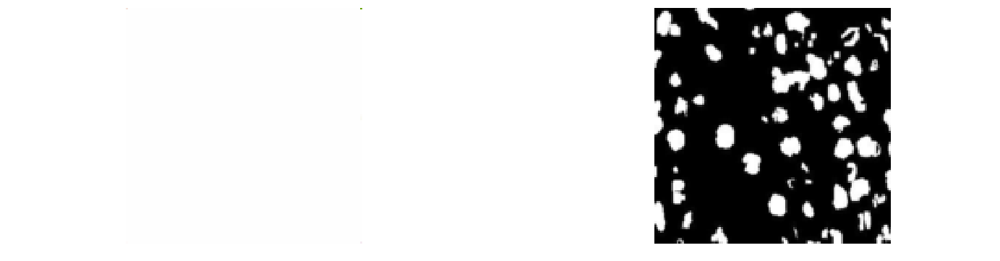

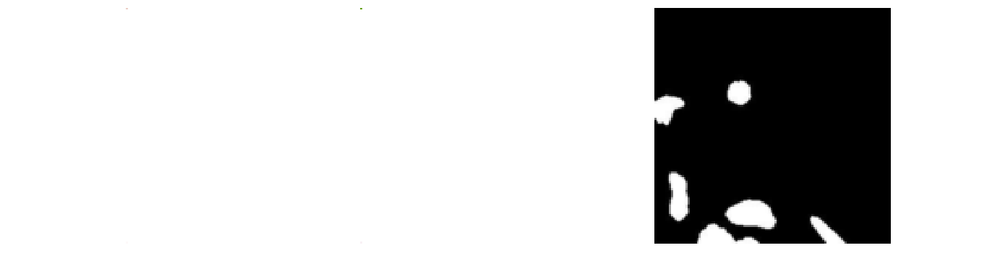

...

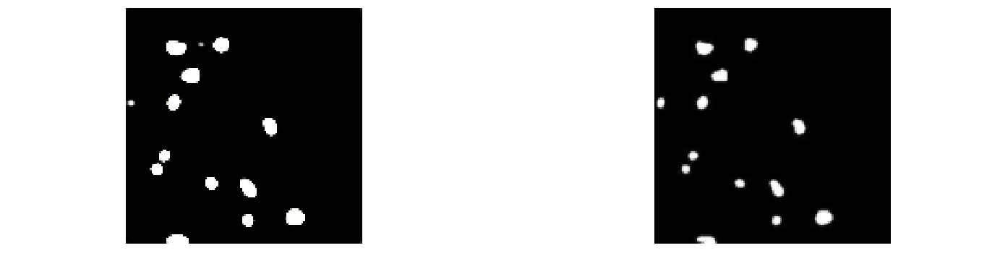

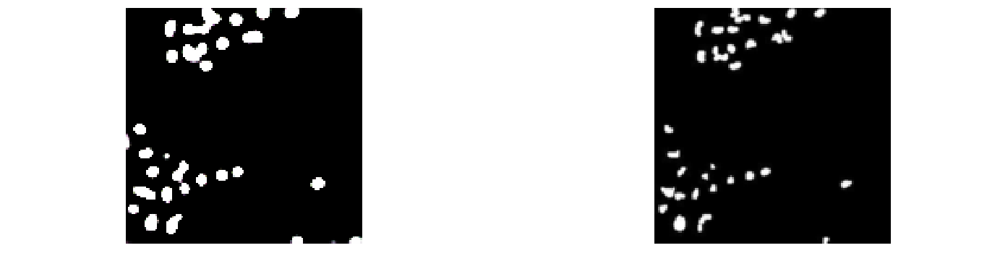

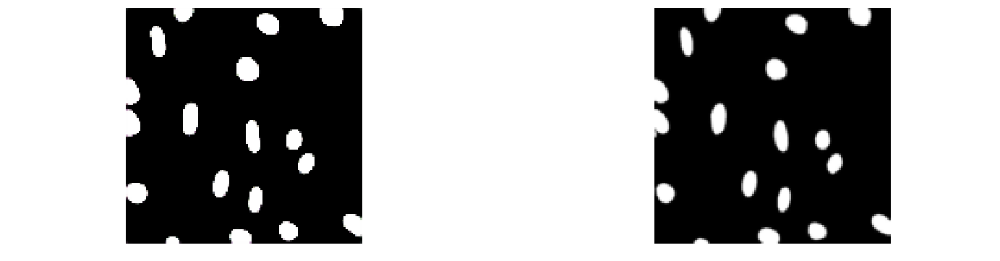

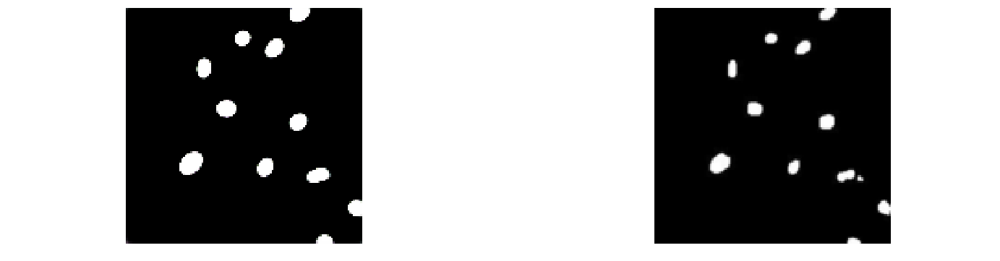

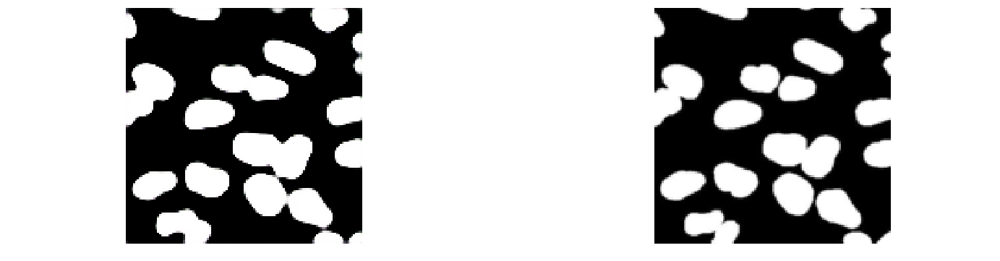

In [17]:
for pred,actual in zip(chunker(predicted_masks, 1),chunker(actual_masks,1)):
    show_n([pred[0], actual[0]],n=2)

OK These look WAY better than I thought they would. Let's run length encode this and make a submission.

What did we learn here?

1 - Some of the predictions are inverted and that should probably be somethig we look at at some point.

2 - RLE encoding fuz images is bad. We'll probably want to threshold the values in our prediction. It could be interesting to try to learn how to do this.

3 - So instead of just rounding stuff we train an algorithm whose job is to only work on edge pixels (between 0.4-0.6) and try to deterimine whether or not they should be in the final mask.

In [107]:
def rle_encoding(x):
    '''
    x: numpy array of shape (height, width), 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = np.where(x.T.flatten()==1)[0] # .T sets Fortran order down-then-right
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b+1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

rles = []
for p in predicted_masks:
    rounded_preds = np.asarray(p.convert('L'))
    r = np.round(rescale(rounded_preds, 0, 1))
    rles.append(rle_encoding(r))

In [108]:
len(rles), len(rles[0])

(670, 388)

In [109]:
#create a custom imageloader that gets the name
class TestImageFolder(ImageFolder):
    def __getitem__(self,index):
        return super(TestImageFolder, self).__getitem__(index), self.imgs[index]

test_dataset = TestImageFolder(os.path.join(IMG_PATH, 'test_img'), img_transform)
test_loader = data.DataLoader(dataset=test_dataset,
                             batch_size=BATCH_SIZE,
                             shuffle=False,
                             num_workers=1)

In [110]:
predicted_names = []
predicted_test = []
for batch, paths in test_loader:
    predicted_names += list(paths[0])
    image_batch = to_variable(batch[0])
    x = unet(image_batch)
    for i in x.data:
        predicted_test.append(transforms.ToPILImage(mode='RGB')(i.cpu()))
#         predicted_test.append(i.cpu().numpy())

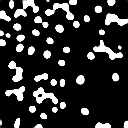

In [111]:
predicted_test[-1]

In [112]:
np.asarray(predicted_test[-1].convert('1'))

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True]])

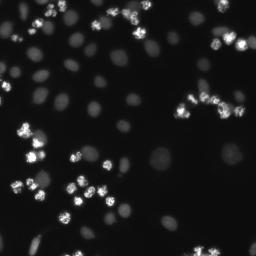

In [113]:
Image.open(predicted_names[-1])

Don't want to look at any more test exmaples. Just want to verify that 1-2 seem right.

In [122]:
import pandas as pd
data_dir = '/home/yvan/projects/data_sci_bowl_2018/data'

sub = pd.read_csv(os.path.join(data_dir,'stage1_sample_submission.csv/stage1_sample_submission.csv'))

test_rles = []
for p, path in zip(predicted_test, predicted_names):
    rounded_preds = np.asarray(p.convert('1'))
    rle = rle_encoding(rounded_preds)
    name = os.path.splitext(os.path.basename(path))[0].split('_')[0]
    test_rles.append(' '.join([str(r) for r in rle]))
sub['EncodedPixels'] = test_rles

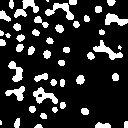

In [123]:
Image.fromarray(rounded_preds, mode='L')

In [124]:
sub

,ImageId,EncodedPixels
0,0114f484a16c152baa2d82fdd43740880a762c93f436c8...,2630 4 2756 7 2883 9 3011 9 3138 9 3266 9 3394...
1,0999dab07b11bc85fb8464fc36c947fbd8b5d6ec498173...,2 1 4 1 21 3 31 8 41 6 56 8 81 5 99 6 111 6 12...
2,0a849e0eb15faa8a6d7329c3dd66aabe9a294cccb52ed3...,76 11 95 12 203 12 223 12 257 2 331 11 351 12 ...
3,0e132f71c8b4875c3c2dd7a22997468a3e842b46aa9bd4...,104 11 232 11 255 1 361 9 381 1 490 7 510 1 62...
4,0ed3555a4bd48046d3b63d8baf03a5aa97e523aa483aaa...,4608 1 4734 3 4862 3 4990 3 5118 3 5246 3 5374...
5,0f1f896d9ae5a04752d3239c690402c022db4d72c0d2c0...,1 70 74 615 692 124 821 123 948 125 1074 153 1...
6,1747f62148a919c8feb6d607faeebdf504b5e2ad42b6b1...,185 3 311 7 438 10 566 10 694 11 709 6 822 12 ...
7,17b9bf4356db24967c4677b8376ac38f826de73a88b93a...,1 16384
8,1879f4f4f05e2bada0ffeb46c128b8df7a79b14c84f38c...,1341 8 1464 18 1589 24 1716 26 1842 30 1969 33...
9,191b2b2205f2f5cc9da04702c5d422bc249faf8bca1107...,3169 4 3296 6 3423 8 3551 8 3679 9 3806 10 393...


In [125]:
sub.to_csv(os.path.join(data_dir, 'submissions','feb182018_2.csv'), index=False)